## Hints of MTM

look at trials' kinematics for hints that mice might be doing something like MTM.
Fit lin. reg.s on speed traces before approaching a curve for evidence of bang bang control. 
Look at deltas and deltat between start of slowing down and start of turning. 

In the end I do a bit of GLM to predict deceleration from position and velocity but it doesn't seem to work yet.

In [1]:
# activate package, basic imports + load data
include("/Users/federicoclaudi/Documents/Github/LocomotionControl/analysis/behavior/analysis_fixtures.jl")
include("/Users/federicoclaudi/Documents/Github/LocomotionControl/analysis/behavior/analysis_visuals.jl")
using HypothesisTests
using Random , GLM

import jcontrol: movingaverage
import jcontrol: trim

# import fractaldim
include("/Users/federicoclaudi/Documents/Github/LocomotionControl/analysis/fractaldim.jl")


  Activating project at `~/Documents/Github/LocomotionControl/analysis/behavior`


@Info (Main):  Loaded 1021 trials 
  ╰──────────────────────────────────────────────── 


                      Thu, 28 Apr 2022 21:59:16 


Main.fractaldim

### Visualize curves

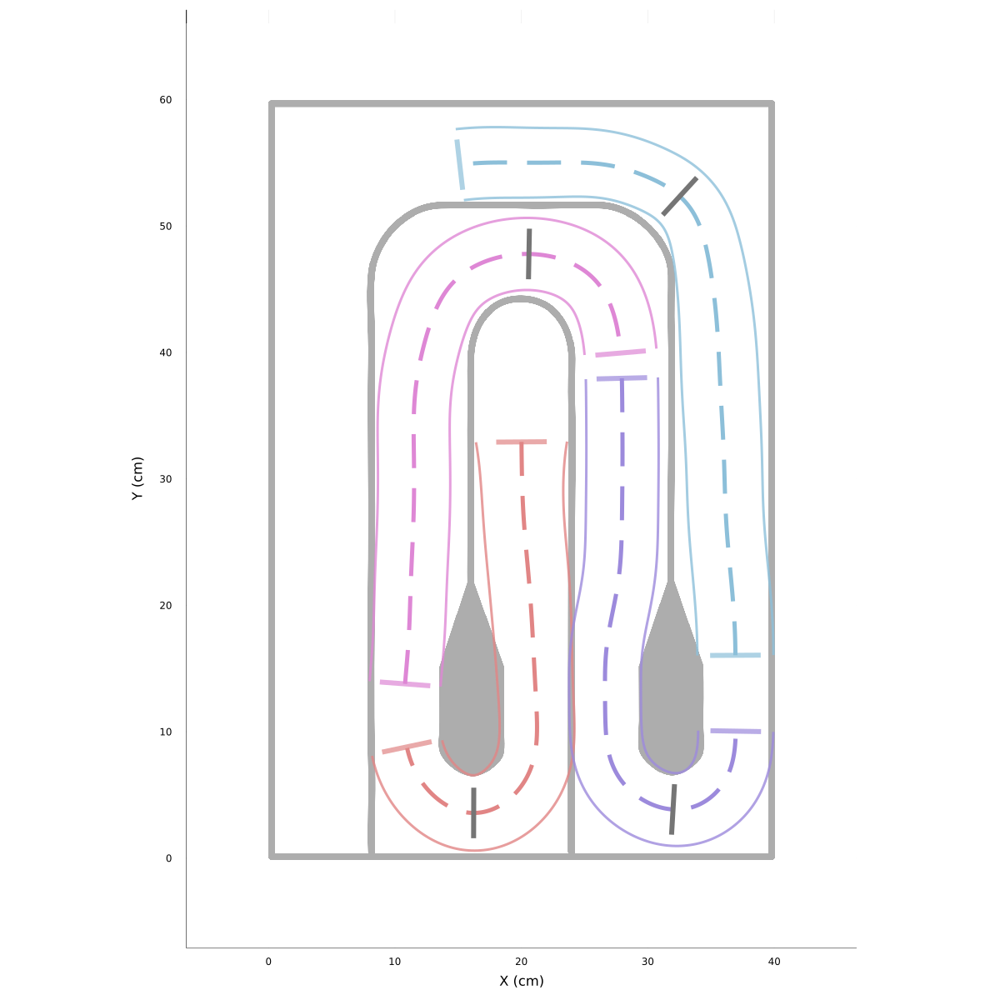

In [2]:


# show curves positions
plt = draw(:arena)

for (i, curve) in enumerate(curves)
    track = trim(FULLTRACK, curve.s0, curve.sf-curve.s0)
    draw!(track, color=curves_colors[i], Δp=50, alpha=1)

    draw!(curve.cp_s0; color=curves_colors[i], alpha=.7)
    draw!(curve.cp_s; color=grey_dark)
    draw!(curve.cp_sf; color=curves_colors[i], alpha=.7)
end

plt

In [3]:
"""
Get the frames in a trial in which the mouse is between s0 and s1
"""
function get_curve_indices(trial, s0, s1)
    start = findlast(trial.s .< s0)
    start = isnothing(start) ? 1 : start
    start += 2

    stop = findfirst(trial.s[start:end] .>= s1) + start
    stop = isnothing(stop) ? length(trial.s) : stop
    stop -= 2

    idxs = repeat([false], length(trial.s))
    idxs[start:stop] .= true
    idx = findfirst(idxs)
    return idxs, idx, start, stop
end


get_curve_indices

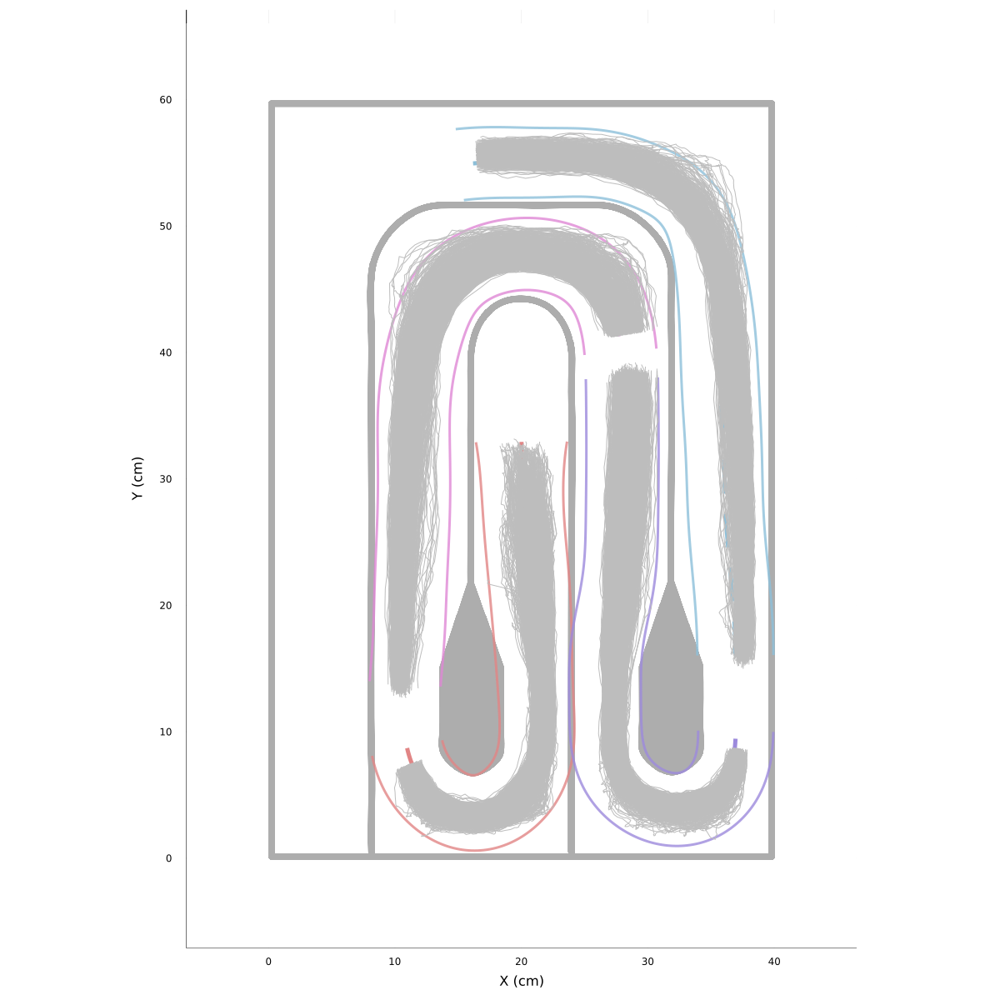

In [4]:
# for each curve, plot the tracking that belong to it
plt = draw(:arena)

for (i, curve) in enumerate(curves)
    track = trim(FULLTRACK, curve.s0, curve.sf-curve.s0)
    draw!(track, color=curves_colors[i], Δp=50, alpha=1)

    for trial in trials
        _, _, start, stop = get_curve_indices(trial, curve.s0, curve.sf)

        plot!(
            trial.x[start:stop], trial.y[start:stop], color=grey, label=nothing
        )

    end

end

plt

### Get slowing down/turning states
For each curve get for each trial where the mouse is when it starts turning vs when it starts slowing down, and what its state is.

In [5]:
# initialize empty data store
data_df = Dict(
    "curve_id" => [],
    "class" => [],  # slowing down/turning
    "x" => [],
    "y" => [],
    "s" => [],
    "u" => [],
    "ω" => [],
    "u̇" => [],
    "t0" => [],
    "tpeak" => [],
    "t1" => [],
    "trial_num" => [],

)


function append_data(data_df, trial, I, cidx, class, u̇, t0, tpeak, t1, trial_num)

    push!(data_df["curve_id"], cidx)
    push!(data_df["class"], class)
    push!(data_df["x"], trial.x[I-1])
    push!(data_df["y"], trial.y[I-1])
    push!(data_df["s"], trial.s[I-1])
    push!(data_df["u"], trial.u[I-1])
    push!(data_df["ω"], trial.ω[I-1])
    push!(data_df["u̇"], u̇)
    push!(data_df["t0"], t0)
    push!(data_df["tpeak"], tpeak)
    push!(data_df["t1"], t1)
    push!(data_df["trial_num"], trial_num)
end


append_data (generic function with 1 method)

### Get start of slowing down

@Info (Main):  Kept 4005 trials/curves combos 
  ╰──────────────────────────────────────────────── 
                      Thu, 28 Apr 2022 22:01:05 


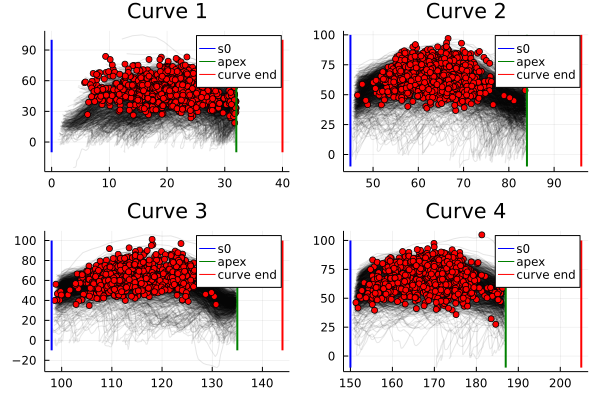

In [6]:
# get when the mice start slowing down
plots = []

kept = 0
for cidx in 1:length(curves)
    curve = curves[cidx]
    s0 = curve.s0
    s1 = curve.s
    
    plt = plot()

    peaks_s, peaks_values = [], []
    for tn in 1:length(trials)
        trial = trials[tn]
        idxs, idx = get_curve_indices(trial, s0, s1)

        u = movingaverage(trial.u, 6)[idxs]

        _idxs, _ = get_curve_indices(trial, s0, curve.sf)
        plot!(trial.s[idxs], u, color="black", alpha=.1, label=nothing)

        duration = length(u) / 60
        (duration > curve.maxdur || duration < .3) && continue

        switchpoint = argmax(u)
        I = switchpoint + idx

        # get additional info
        info = Dict(
            "mean_u̇" => mean(diff(u[switchpoint:end]))
        )

        u̇ = mean(diff(filter(!isnan, u[switchpoint:end])))
        append_data(data_df, trial, I, cidx, "slowing", u̇, idx, I-1, idx+length(u), tn)
        push!(peaks_s, trial.s[I-1])
        push!(peaks_values, trial.u[I-1])
        kept += 1
    end

    # scatter position of u̇ peaks
    scatter!(
        peaks_s, peaks_values, color="red", label=nothing, alpha=1
    )
    plot!([s0, s0], [-10, 100], lw=2, color="blue", label="s0", title="Curve $cidx")
    plot!([curve.s, curve.s], [-10, 100], lw=2, color="green", label="apex")
    plot!([curve.sf, curve.sf], [-10, 100], lw=2, color="red", label="curve end")
    push!(plots, plt)
end



@info "Kept $kept trials/curves combos"
plot(
    plots...; figsize=(900, 900)
)


### Get start of turning

@Info (Main):  Kept 4005 trials/curves combos 
  ╰──────────────────────────────────────────────── 
                      Thu, 28 Apr 2022 22:01:09 


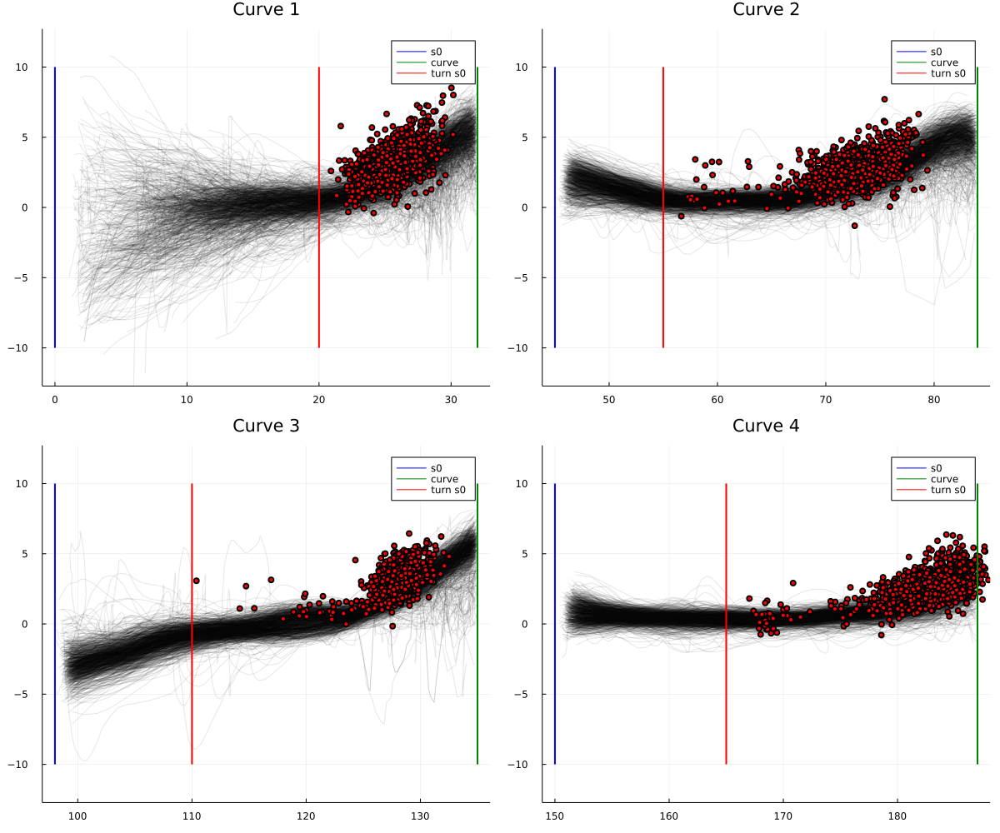

In [7]:
plots = []
kept = 0
for cidx in 1:length(curves)
    curve = curves[cidx]
    s0 = curve.s0
    s1 = curve.s
    
    plt = plot()

    peaks_s, peaks_values = [], []
    for tn in 1:length(trials)
        trial = trials[tn]
        idxs, idx = get_curve_indices(trial, s0, s1)

        s = movingaverage(trial.s[idxs], 6)
        ω = movingaverage(trial.ω[idxs], 6) .* curve.direction
        plot!(trial.s[idxs], ω, color="black", alpha=.1, label=nothing)

        duration = length(ω) / 60
        (duration > curve.maxdur || duration < .3) && continue

        # get when it starts turning
        t0 = findfirst(s .> curve.tpos)
        t0 = isnothing(t0) ? 1 : t0
        th = 1.5
        switchpoint = findfirst(ω[t0:end] .> th)
        switchpoint = isnothing(switchpoint) ? 1 : switchpoint
        
        while isnothing(switchpoint) && th > 0
            th -= .1
            switchpoint = findfirst(ω[t0:end] .> th)
        end
        switchpoint += t0
        switchpoint = isnothing(switchpoint) ? switchpoint = findlast(abs.(ω) .< 1.0) : switchpoint
        I = switchpoint + idx

        append_data(data_df, trial, I, cidx, "turning", 0.0, idx+t0, I-1, idx+length(ω), tn)
        push!(peaks_s, trial.s[I-1])
        push!(peaks_values, trial.ω[I-1] * curve.direction)
        kept += 1
    end

    # scatter position of u̇ peaks
    scatter!(
        peaks_s, peaks_values, color="red", label=nothing, alpha=1
    )
    plot!([s0, s0], [-10, 10], lw=2, color="blue", label="s0")

    plot!([curve.s, curve.s], [-10, 10], lw=2, color="green", label="curve", title="Curve $cidx", xlim=[s0, s1], ylim=[-12, 12])
    plot!([curve.tpos, curve.tpos], [-10, 10], lw=2, color="red", label="turn s0")

    push!(plots, plt)
end

@info "Kept $kept trials/curves combos"

plot(
    plots..., size=(1200, 1000)
)


In [8]:
# put data together

df = DataFrame(data_df)
df[!,:class] = convert.(String,df[!,:class])

for col in (:curve_id, :t0, :t1, :tpeak, :trial_num)
    df[!,col] = convert.(Int,df[!,col])
end

for col in (:x, :y, :s, :u, :ω, :u̇)
    df[!, col] = convert.(Float64, df[!, col])
end


df

,class,curve_id,s,t0,t1,tpeak,trial_num,u,u̇
,String,Int64,Float64,Int64,Int64,Int64,Int64,Float64,Float64
1,slowing,1,20.1675,3,22,9,1,76.1958,-2.11549
2,slowing,1,21.8771,3,27,15,2,80.3603,-1.88123
3,slowing,1,25.9109,3,25,15,3,79.0232,-3.08989
4,slowing,1,19.4374,3,25,10,4,73.3007,-2.16837
5,slowing,1,16.8363,3,28,10,5,60.6383,-1.13452
6,slowing,1,17.9874,3,25,10,6,63.2308,-1.58452
7,slowing,1,17.1132,3,28,10,7,61.1084,-1.45108
8,slowing,1,22.8211,3,32,21,8,63.9678,-2.50856
9,slowing,1,9.42716,3,28,3,9,68.077,-1.00987


## Accelerations analysis

We take the time before/after peak velocity for each trial approaching each curve. We fit a linear regression to the before/after speed trace and we look at distributions of slopes (compared to shuffled data). The idea is that, as per MTM predictions, mice go from a period of max acceleration to a period of max deceleration.

In [9]:


function slope(x, y)
    X = hcat(x, ones(length(x)))
    model = lm(X, y)
    return coef(model)[1] * 60
end

function append_slopes_data(slope, class, curvidx)
    push!(slopes_data["slope"], slope)
    push!(slopes_data["class"], class)
    push!(slopes_data["curve_id"], curvidx)
end

# loop over curves
slopes_data = Dict(
    "slope"=>[],
    "class"=>[],
    "curve_id"=>[],
)



for curvidx in 1:4
    slowing = filterdf(df, :curve_id, curvidx, :class, "slowing")

    # loop over trials
    for i in 1:size(slowing, 1)
        tn = slowing[i,:trial_num]
        t0, tpeak, t1 = slowing[i,:t0], slowing[i,:tpeak]-2, slowing[i,:t1]

        # get slopes
        append_slopes_data(slope(S[tn][t0:tpeak],  U[tn][t0:tpeak]), "pre", curvidx)
        append_slopes_data(slope(S[tn][tpeak+1:t1],  U[tn][tpeak+1:t1]), "post", curvidx)

        # get slope of shuffled data
        U_shuffle = shuffle(U[tn][t0:t1])
        append_slopes_data(slope(S[tn][t0:t1],  U_shuffle), "shuffled", curvidx)

    end

end


data = DataFrame(slopes_data)

,class,curve_id,slope
,Any,Any,Any
1,pre,1,299.872
2,post,1,-157.949
3,shuffled,1,45.1669
4,pre,1,75.4743
5,post,1,-122.675
6,shuffled,1,10.7499
7,pre,1,43.3987
8,post,1,-252.107
9,shuffled,1,-62.1434


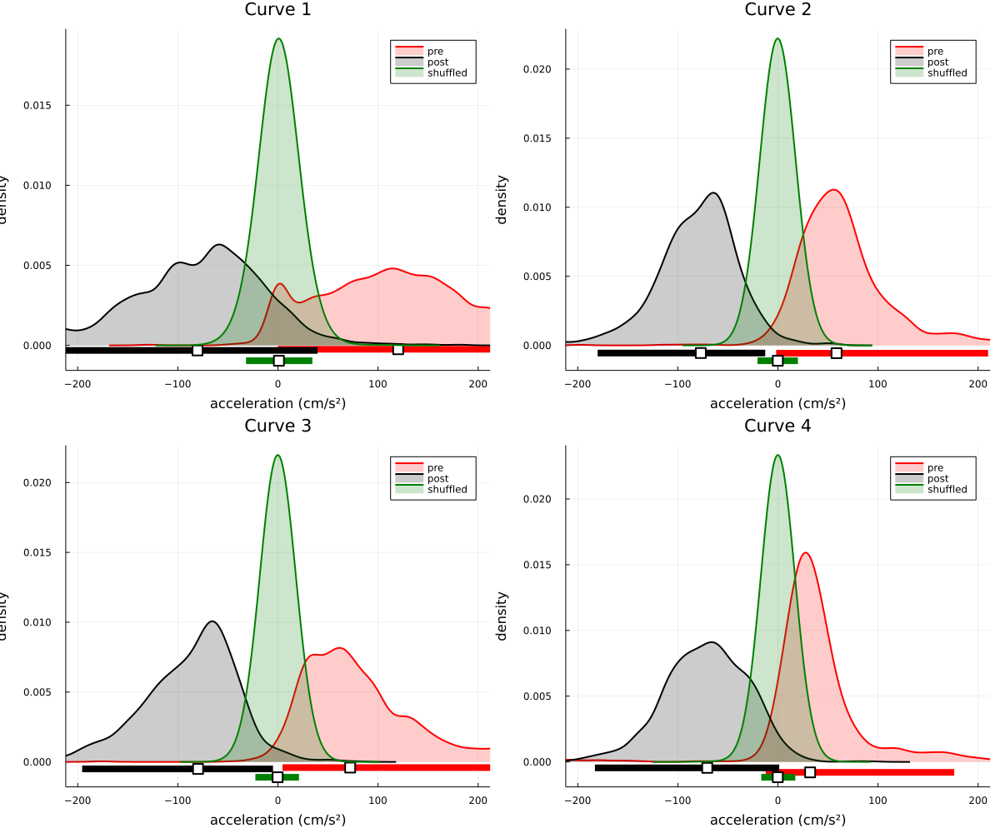

In [10]:
plots = []

for i in 1:length(curves)

    pre = filterdf(data, :curve_id, i, :class, "pre")
    post = filterdf(data, :curve_id, i, :class, "post")
    shuffled = filterdf(data, :curve_id, i, :class, "shuffled")

    # bw = 1 == 1 ? 15 : 12

    plt = plot_kde_and_CI(pre[:,:slope]; bandwidth = 10, color="red", label="pre")
    plot_kde_and_CI!(post[:,:slope]; bandwidth = 10, color="black", label="post")
    plot_kde_and_CI!(shuffled[:,:slope]; bandwidth = 15, color="green", label="shuffled")

    plot!(; xlim=[-200, 200], xlabel="acceleration (cm/s²)", ylabel="density", title="Curve $i", legend=true)

    push!(plots, plt)

end

plot(plots...; size=(1200, 1000))

## Slowing/turning positions analysis

We look at where the mice are when they start slowing down before a turn compared to when they start turning to confirm that mice slow down first and turn only later.

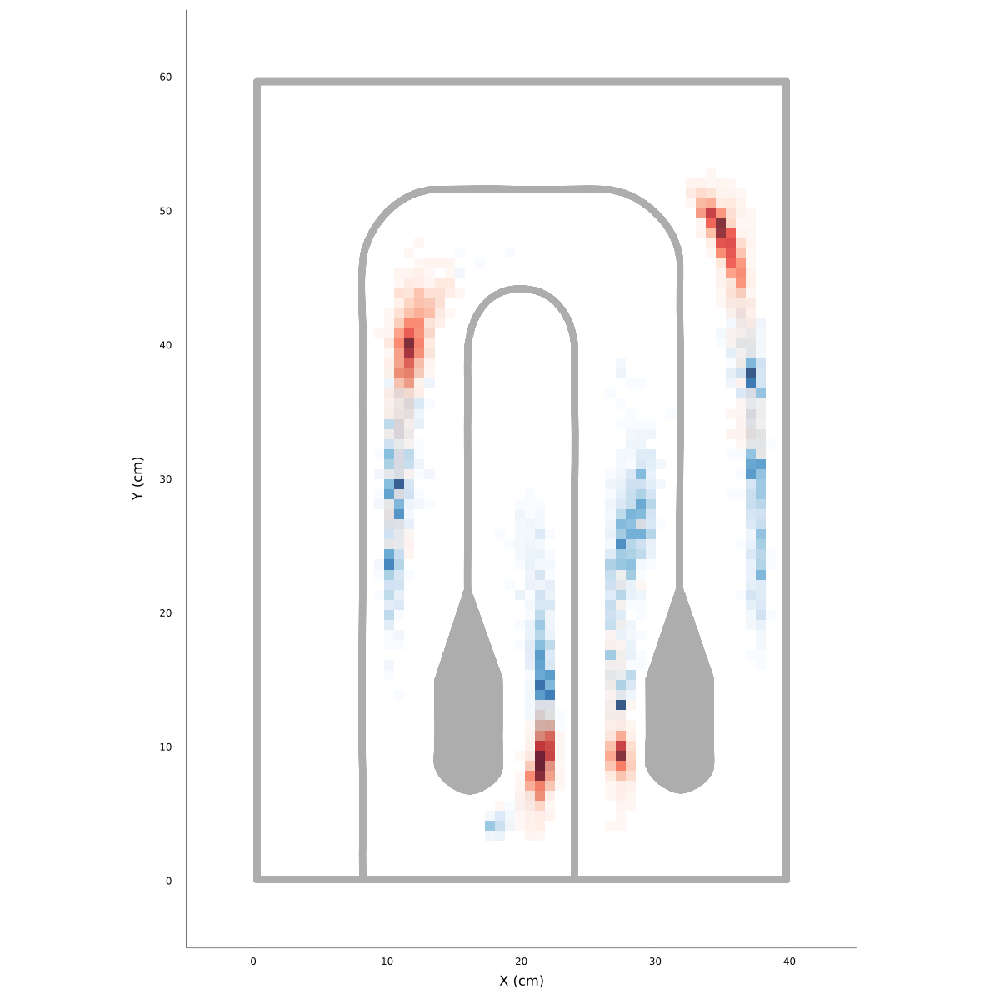

In [11]:


plt = draw(:arena)

xbins = 0:.75:40
ybins = 0:.75:60

for i in 1:length(curves)
    slowing = filterdf(df, :curve_id, i, :class, "slowing")
    turning = filterdf(df, :curve_id, i, :class, "turning")

    histogram2d!(slowing.x, slowing.y, bins=(xbins, ybins),  alpha=.8, c=:Blues, colorbar_entry=false)
    histogram2d!(turning.x, turning.y, bins=(xbins, ybins),  alpha=.8, c=:Reds, colorbar_entry=false)    
end


plt


we can also look at the Δs: the distance between where the mice are when they start slowing down compared to when they start turning. Values >0 means that the mice start slowing first and only turn later

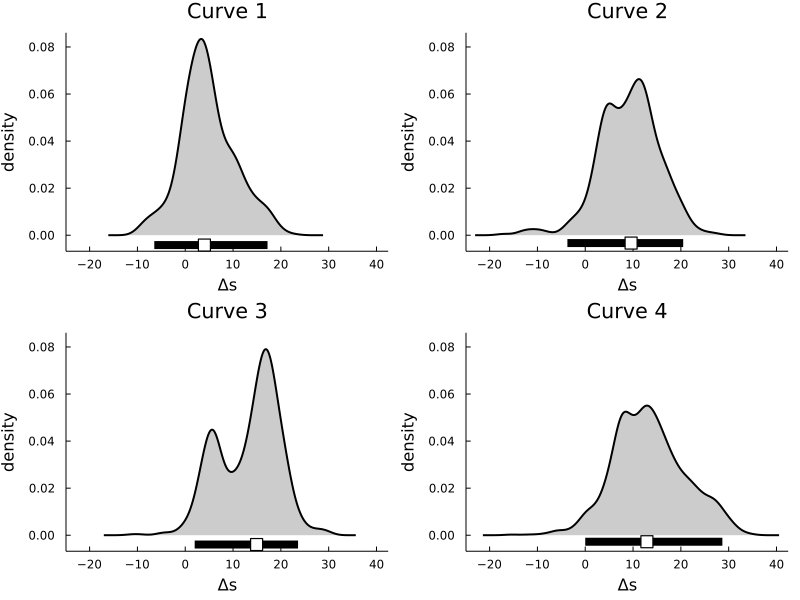

In [12]:
# plot Δs
plots = []
for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    turning = filterdf(df, "curve_id", curve_idx, "class", "turning")

    @assert size(slowing) == size(turning) "wtf at curve $curve_idx"

    Δs = turning.s .- slowing.s
    plt = plot_kde_and_CI(Δs, bandwidth = 1.5)
    plot!(; xlabel="Δs", ylabel="density", title="Curve $curve_idx", legend=false)
    push!(plots, plt)

end

plot(plots...; size=(800, 600), link=:all, grid=false)

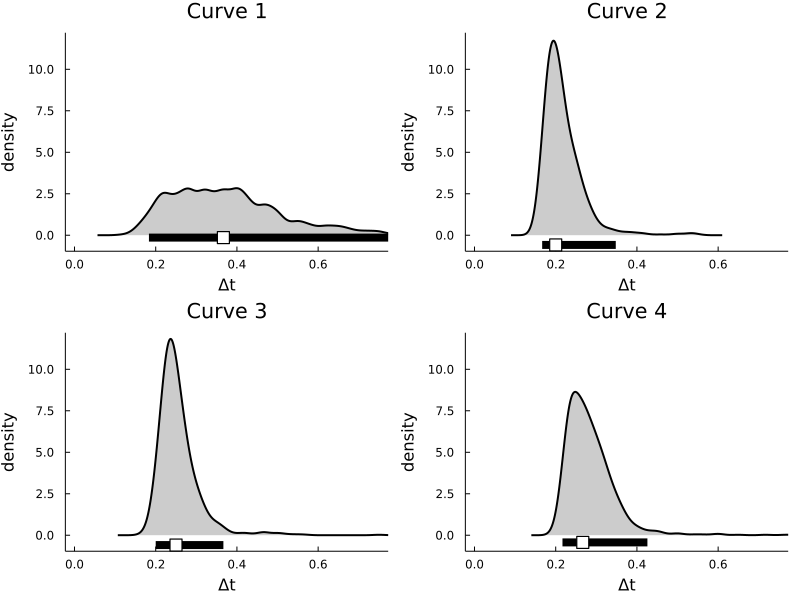

In [13]:
# plot Δt
plots = []
for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    turning = filterdf(df, "curve_id", curve_idx, "class", "turning")

    @assert size(slowing) == size(turning)

    Δt = (turning.t0 .- slowing.t0) ./ 60
    plt = plot_kde_and_CI(Δt, bandwidth = .015)
    plot!(; xlabel="Δt", ylabel="density", title="Curve $curve_idx", legend=false, xlim=[0, .75])
    push!(plots, plt)


end

plot(plots...; size=(800, 600), link=:all, grid=false)

We can also plot the speed at which the mice are going when they start turning compared to when they start slowing down

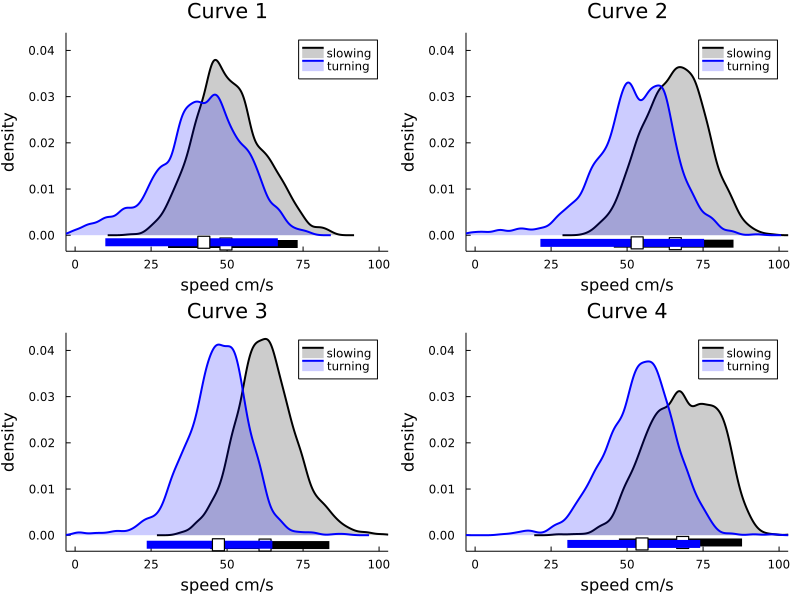

In [14]:
plots = []
for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")
    turning = filterdf(df, "curve_id", curve_idx, "class", "turning")

    plt = plot_kde_and_CI(slowing.u, bandwidth = 2, color="black", label="slowing")
    plot_kde_and_CI!(turning.u, bandwidth = 2, color="blue", label="turning")
    plot!(; xlabel="speed cm/s", ylabel="density", title="Curve $curve_idx", legend=true, xlim=[0, 100])

    push!(plots, plt)
end

plot(plots...; size=(800, 600), link=:all, grid=false)

Finally, we can look at how the ammount of deceleration relates to two other important variables: the speed of the mice when they start slowing down and how close they are to where they need to turn.

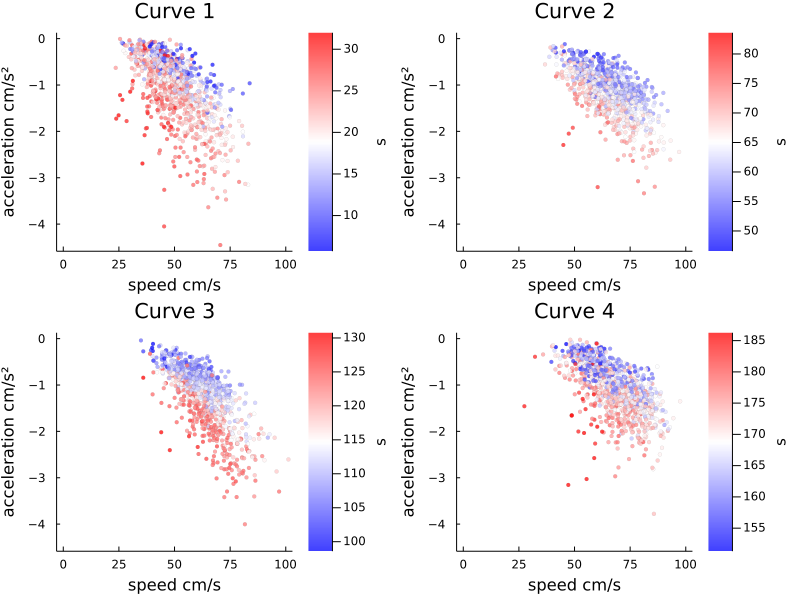

In [15]:
slowing = filterdf(df, "class", "slowing")

plots = []

for curve_idx in 1:4
    slowing = filterdf(df, "curve_id", curve_idx, "class", "slowing")

    plt = scatter(
        slowing.u, slowing.u̇, marker_z=slowing.s, c=:bwr, alpha=.75, msw=0.0, label=nothing, ms=3
    )
    plot!(; xlabel="speed cm/s", ylabel="acceleration cm/s²", title="Curve $curve_idx", legend=false, xlim=[0, 100], colorbar_title="s")

    push!(plots, plt)
end

plot(plots...; size=(800, 600), link=:all, grid=false)



# Tortuosity analysis.
For each trial at each curve, get the tortuosity measure, try to cluster trials into two groups based on the torosoty, then look at them separately.

In [16]:
resolutions = collect(.1:.25:1)

for (i, curve) in enumerate(curves)
    Ds = []
    track = trim(FULLTRACK, curve.s0, curve.sf-curve.s0)

    for trial in trials
        _, _, start, stop = get_curve_indices(trial, curve.s0, curve.sf)

        x = trial.x[start:stop]
        y = trial.y[start:stop]

        D = fractaldim.estimate_dim(x, y, resolutions)
        push!(Ds, D)
        sleep(0.001)
    end
    break
end




──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    1/1021   0%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    1/1021   0%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    3/1021   0%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    4/1021   0%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    5/1021   0%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    6/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    7/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    8/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●    9/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●   10/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ●                                               ●   11/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   12/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   13/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   14/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   15/1021   1%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   16/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   17/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   18/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   19/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   20/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   21/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   22/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   23/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   24/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   25/1021   2%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   26/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   27/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   28/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   29/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   30/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   31/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   32/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   33/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━                                             ●   34/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   35/1021   3%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   36/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   37/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   38/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   39/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   40/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   41/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   42/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   43/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   44/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   45/1021   4%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   46/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   47/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   48/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   49/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   50/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   51/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   52/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   53/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   54/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   55/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━                                            ●   56/1021   5%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   57/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   58/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   59/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   60/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   61/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   62/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   63/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   64/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   65/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   66/1021   6%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   67/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   68/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   69/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   70/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   71/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   72/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   73/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   74/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   75/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   76/1021   7%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   77/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   78/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━                                           ●   79/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   80/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   81/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   82/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   83/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   84/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   85/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   86/1021   8%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   87/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   88/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   89/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   90/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   91/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   92/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   93/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   94/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   95/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   96/1021   9%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   97/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   98/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●   99/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●  100/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●  101/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━                                          ●  102/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  103/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  104/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  105/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  106/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  107/1021  10%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  108/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  109/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  110/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  111/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  112/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  113/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  114/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  115/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  116/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  117/1021  11%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  118/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  119/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  120/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  121/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  122/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  123/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━                                         ●  124/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  125/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  126/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  127/1021  12%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  128/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  129/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  130/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  131/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  132/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  133/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  134/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  135/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  136/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  137/1021  13%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  138/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  139/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  140/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  141/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  142/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  143/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  144/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  145/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  146/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━                                        ●  147/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  148/1021  14%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  149/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  150/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  151/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  152/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  153/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  154/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  155/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  156/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  157/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  158/1021  15%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  159/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  160/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  162/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  163/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  164/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  165/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  166/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  167/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  168/1021  16%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  169/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━                                       ●  170/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  171/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  172/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  173/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  174/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  175/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  176/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  177/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  178/1021  17%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  179/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  180/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  181/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  182/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  183/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  184/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  185/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  186/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  187/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  188/1021  18%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  189/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  191/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━                                      ●  192/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  193/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  194/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  195/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  196/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  197/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  198/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  199/1021  19%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  200/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  201/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  202/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  203/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  204/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  205/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  206/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  207/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  208/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  209/1021  20%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  210/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  211/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  212/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  213/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  214/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━                                     ●  215/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  216/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  217/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  218/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  219/1021  21%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  220/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  221/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  222/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  223/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  224/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  225/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  226/1021  22%

──────────────────────────────── progress ─────────────────────────────────
Running... ● ━━━━━━━━━━                                    ●  227/1021  22%

### GLM analysis
To quantify the effect of various variables on the degree of decelaration, we fit a GLM.

In [ ]:
using GLM, MLDataUtils, StatsBase
import DataFrames: mapcols, dropmissing

normalize and split database

In [ ]:
# TODO: this shuld use a fit of linear regression to the speed trace instead of u̇? Are they the same?

# filter and cleanup
slowing = filterdf(df, "class", "slowing")[:, [:x, :y, :u, :s, :ω, :trial_num, :tpeak, :t1]]
# slowing = slowing[.!isnan.(slowing.u̇), :]


# get decleration slope for each trial
u̇ = []

for i in 1:size(slowing, 1)
    tn = slowing[i,:trial_num]
    tpeak, t1 = slowing[i,:tpeak]-2, slowing[i,:t1]

    # get slopes
    push!(u̇, slope(S[tn][tpeak:t1],  U[tn][tpeak:t1]))
end

# add/remove columns
slowing = slowing[:, [:x, :y, :u, :s, :ω]]
slowing[:, :u̇] = Vector{Float64}(u̇)


# normalize and split
slowing = mapcols(zscore, (slowing))
trainset, testset = splitobs(slowing)
trainset

In [ ]:
trainset, testset = splitobs(slowing)

model = glm(
    @formula(u̇ ~ s + u), 
    slowing, 
    Normal(),
)


TODO: eval on test set.
TODO: make pltos out of it

In [ ]:
u̇ = [slowing.u̇...,  trainset.u̇..., testset.u̇...]
û = [predict(model, slowing)..., predict(model, trainset)..., predict(model, testset)...]
label = vcat(
    repeat(["all"], size(slowing, 1)),
    repeat(["train"], size(trainset, 1)), 
    repeat(["test"], size(testset, 1))
)
fig = Figure()
ax = Axis(fig[1, 1], xlabel="u̇ actual", ylabel="u̇ pred")
lines!(ax, [-3, 3], [-3, 3], color=:black, linewidth=4)

graph = data((u̇ = u̇, û = û, label=label)) * 
            (visual(Scatter, alpha=.25) + linear() * visual(color="red")) * 
            mapping(:u̇, :û, color=:label)

draw!(ax, graph)
xlims!(ax, [-3, 3])
ylims!(ax, (-3.0, 3.0))
fig